In [1]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

from datetime import timedelta, datetime
#import holidays

import matplotlib
import pickle
import seaborn as sns

import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objs as go

matplotlib.pyplot.style.use('ggplot')
%matplotlib inline

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format', lambda x: '%.6f' % x)
pd.set_option('display.width', 500)

In [2]:
df_wealthy = pd.read_csv('../../../data/train_economic_class/df_wealthy.csv')

In [3]:
df_wealthy.shape

(35752, 29)

In [4]:
df_wealthy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35752 entries, 0 to 35751
Data columns (total 29 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   ID                      35752 non-null  int64  
 1   TARGET                  35752 non-null  float64
 2   open_year               35752 non-null  int64  
 3   open_month              35752 non-null  int64  
 4   first_prediction        35752 non-null  float64
 5   log_first_prediction    35752 non-null  float64
 6   economic_class          35752 non-null  object 
 7   log_TARGET              35752 non-null  float64
 8   Retention_count_D0_3    35752 non-null  int64  
 9   Retention_count_D4_7    35752 non-null  int64  
 10  Retention_count_D8_11   35752 non-null  int64  
 11  Retention_count_D12_15  35752 non-null  int64  
 12  Avg_Lvl_Count_D0_3      35752 non-null  float64
 13  Avg_Lvl_Count_D4_7      35752 non-null  float64
 14  Avg_Lvl_Count_D8_11     35752 non-null

In [5]:
df_wealthy.describe()

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
count,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000,35752.000000
mean,441617.807339,0.944412,2024.000000,2.938745,332.239091,5.643240,-22.338154,1.673501,0.477540,0.330919,0.260992,4.917900,1.045284,0.709667,0.540795,40.502443,70.728505,63.097449,1.507930,0.352637,0.227240,0.167223,0.018320,0.004234,0.002635,0.002526,2.255030,0.027715
std,253607.072851,6.618439,0.000000,1.278288,262.193248,0.515587,12.971884,0.931724,0.947179,0.816358,0.733554,7.554695,4.772320,4.179902,3.691235,90.054659,101.247434,115.797585,3.044259,1.553629,1.342408,1.157788,0.234071,0.109192,0.082345,0.082372,5.500900,0.329971
min,65.000000,0.000000,2024.000000,1.000000,156.027973,5.050035,-30.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,221747.500000,0.000000,2024.000000,2.000000,184.001774,5.214945,-30.000000,1.000000,0.000000,0.000000,0.000000,1.750000,0.000000,0.000000,0.000000,18.000000,27.500000,8.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,440499.500000,0.000000,2024.000000,3.000000,247.040220,5.509551,-30.000000,1.000000,0.000000,0.000000,0.000000,3.000000,0.000000,0.000000,0.000000,26.000000,44.750000,47.333333,0.510268,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.684826,0.000000
75%,662013.500000,0.004060,2024.000000,4.000000,394.992404,5.978867,-5.506645,2.000000,1.000000,0.000000,0.000000,5.000000,0.000000,0.000000,0.000000,44.000000,85.250000,81.333333,1.699561,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.259672,0.000000
max,878581.000000,386.494019,2024.000000,5.000000,4944.476604,8.506026,5.957116,4.000000,4.000000,4.000000,4.000000,204.750000,260.250000,296.250000,235.250000,8356.666667,4841.250000,7218.000000,91.707404,56.353756,85.259599,101.214085,7.780500,6.500000,5.193500,5.200000,295.808025,10.387000


In [6]:
df_wealthy[(round(df_wealthy['log_TARGET'], 1) <= -29.9)].count()

ID                        26452
TARGET                    26452
open_year                 26452
open_month                26452
first_prediction          26452
log_first_prediction      26452
economic_class            26452
log_TARGET                26452
Retention_count_D0_3      26452
Retention_count_D4_7      26452
Retention_count_D8_11     26452
Retention_count_D12_15    26452
Avg_Lvl_Count_D0_3        26452
Avg_Lvl_Count_D4_7        26452
Avg_Lvl_Count_D8_11       26452
Avg_Lvl_Count_D12_15      26452
Avg_Duration_Lvl0_3       26452
Avg_Duration_Lvl4_7       26452
Avg_Duration_Lvl8_10      26452
Total_AdRevenueD0_3       26452
Total_AdRevenueD4_7       26452
Total_AdRevenueD8_11      26452
Total_AdRevenueD12_15     26452
Total_IAPRevenueD0_3      26452
Total_IAPRevenueD4_7      26452
Total_IAPRevenueD8_11     26452
Total_IAPRevenueD12_15    26452
Total_AdRevenue           26452
Total_IAPRevenue          26452
dtype: int64

In [7]:
df_wealthy['target_class'] = np.where(round(df_wealthy['log_TARGET'], 1) <= -29.9, 1, 0) # class 1 means TARGET is 0.0 

In [8]:
X_cols = [col for col in df_wealthy.columns if col not in ['ID', 'open_year', 'open_month', 'economic_class', 'TARGET', 'log_TARGET']]

In [9]:
df_wealthy['target_class'].value_counts()

target_class
1    26452
0     9300
Name: count, dtype: int64

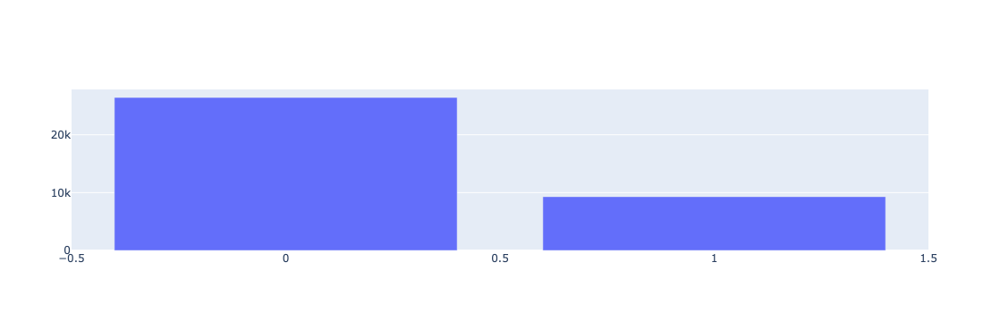

In [10]:
fig = go.Figure([go.Bar(x = [0, 1], y = df_wealthy.target_class.value_counts())])
fig.show()

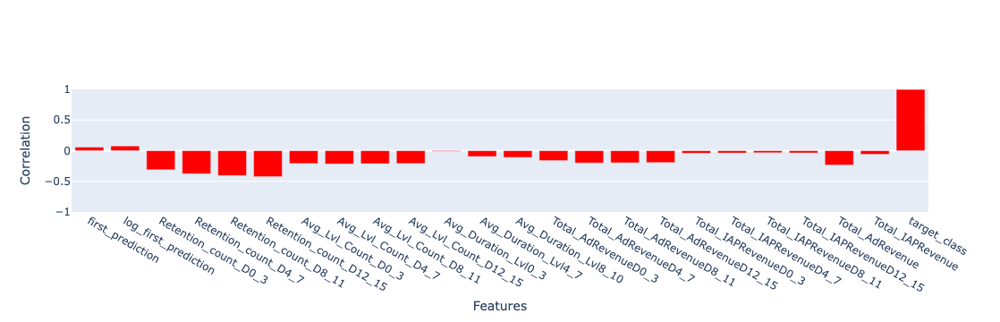

In [11]:
target_corr = df_wealthy[X_cols].corr()['target_class']

fig = go.Figure([go.Bar(y = target_corr, x = target_corr.index, marker_color = 'red')])

fig.update_layout(xaxis_title = "Features", yaxis_title = "Correlation",
    yaxis = dict(
        range=(-1, 1),
        showticklabels=True
    ))
fig.show()

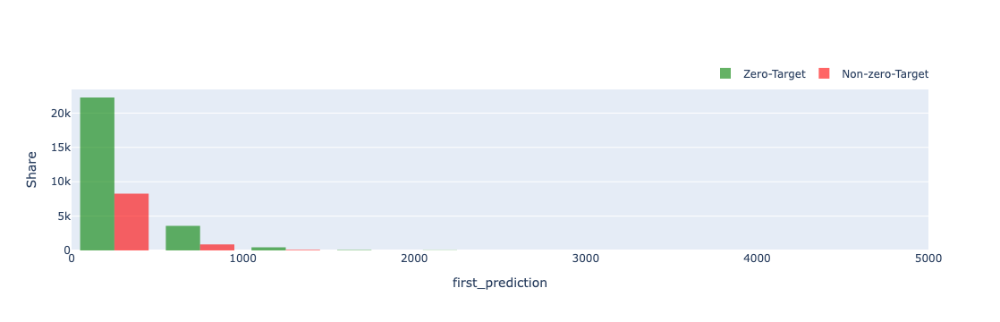

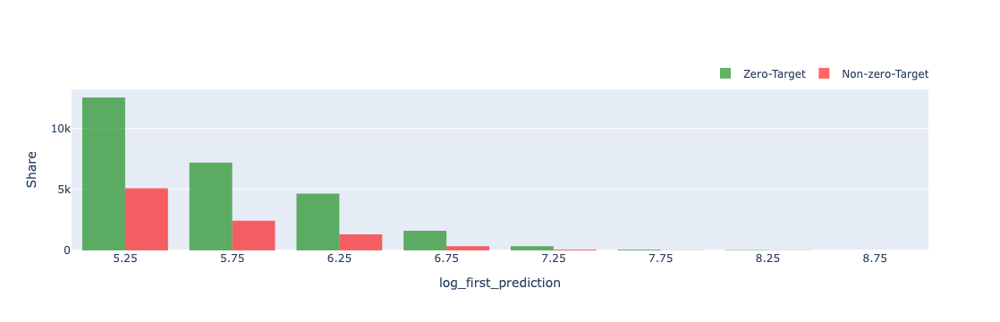

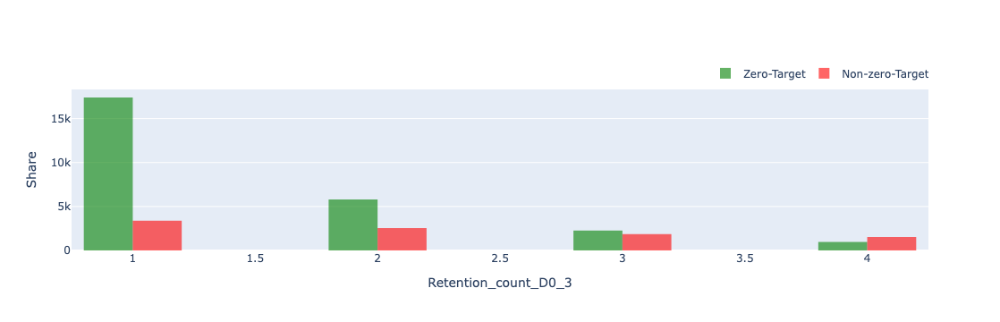

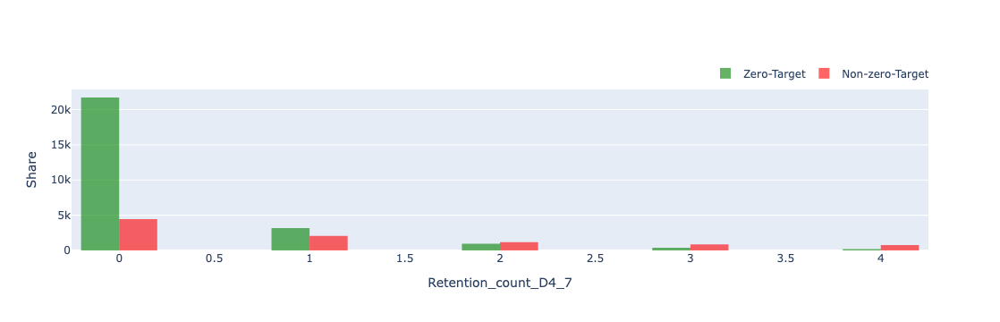

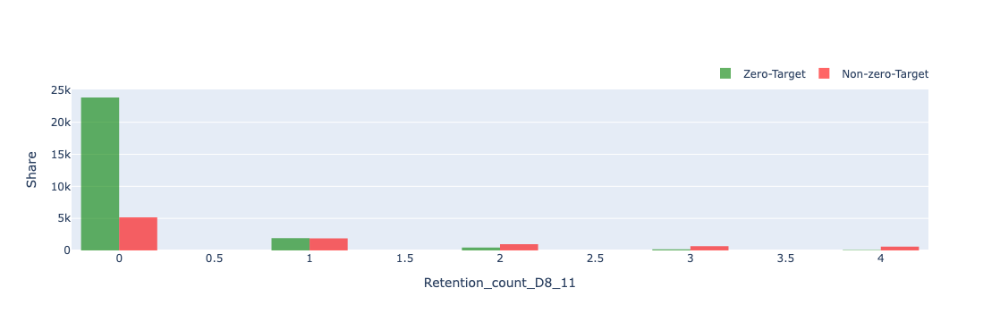

...

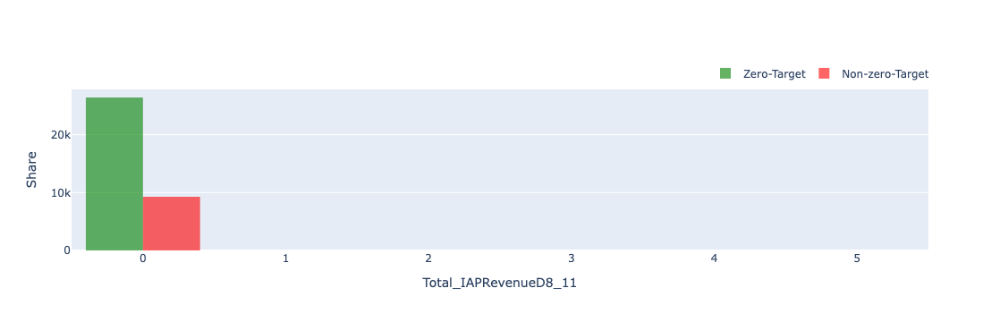

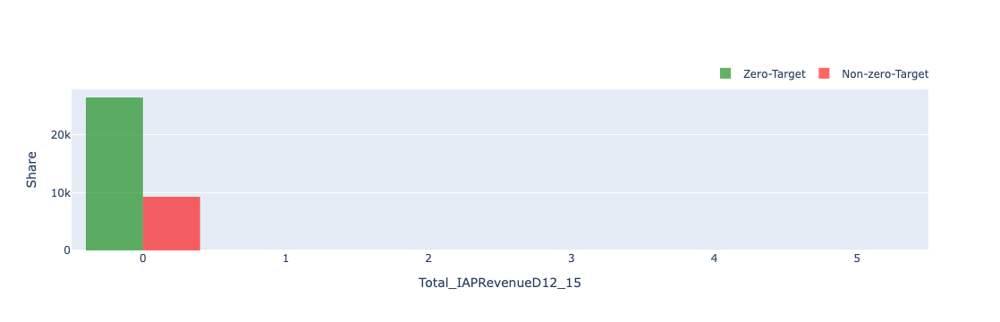

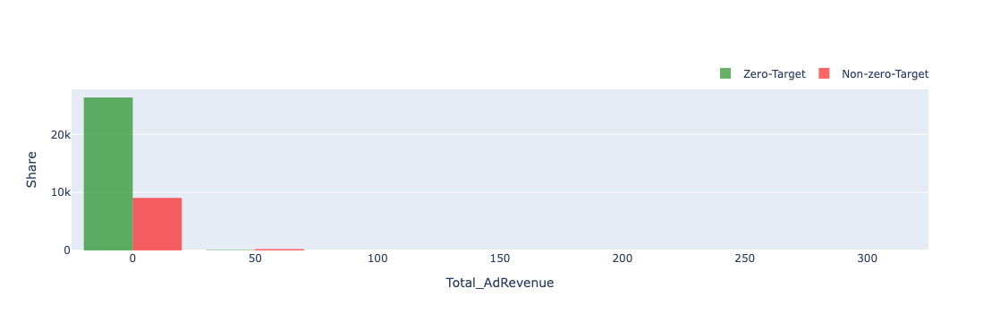

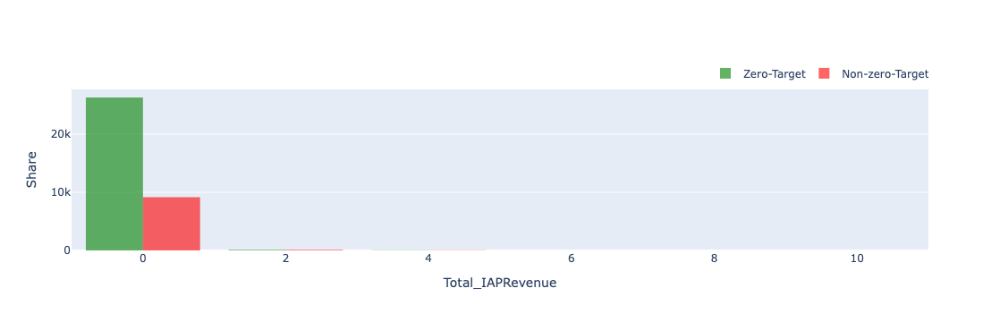

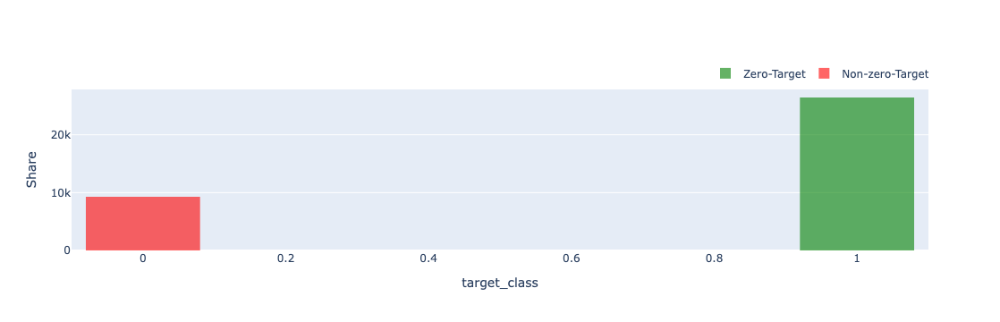

In [12]:
for feature in X_cols:

    fig = go.Figure()
    fig.add_trace(go.Histogram(x = df_wealthy[df_wealthy.target_class == 1][feature],
                 marker_color = 'green', opacity = 0.6, nbinsx = 10,  name = 'Zero-Target'))

    fig.add_trace(go.Histogram(x = df_wealthy[df_wealthy.target_class == 0][feature],
                 marker_color = 'red', opacity = 0.6,nbinsx = 10, name = 'Non-zero-Target'))

    fig.update_layout(
        legend = dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
        ),
        xaxis_title = feature,
        yaxis_title = "Share"
    )
    fig.show()

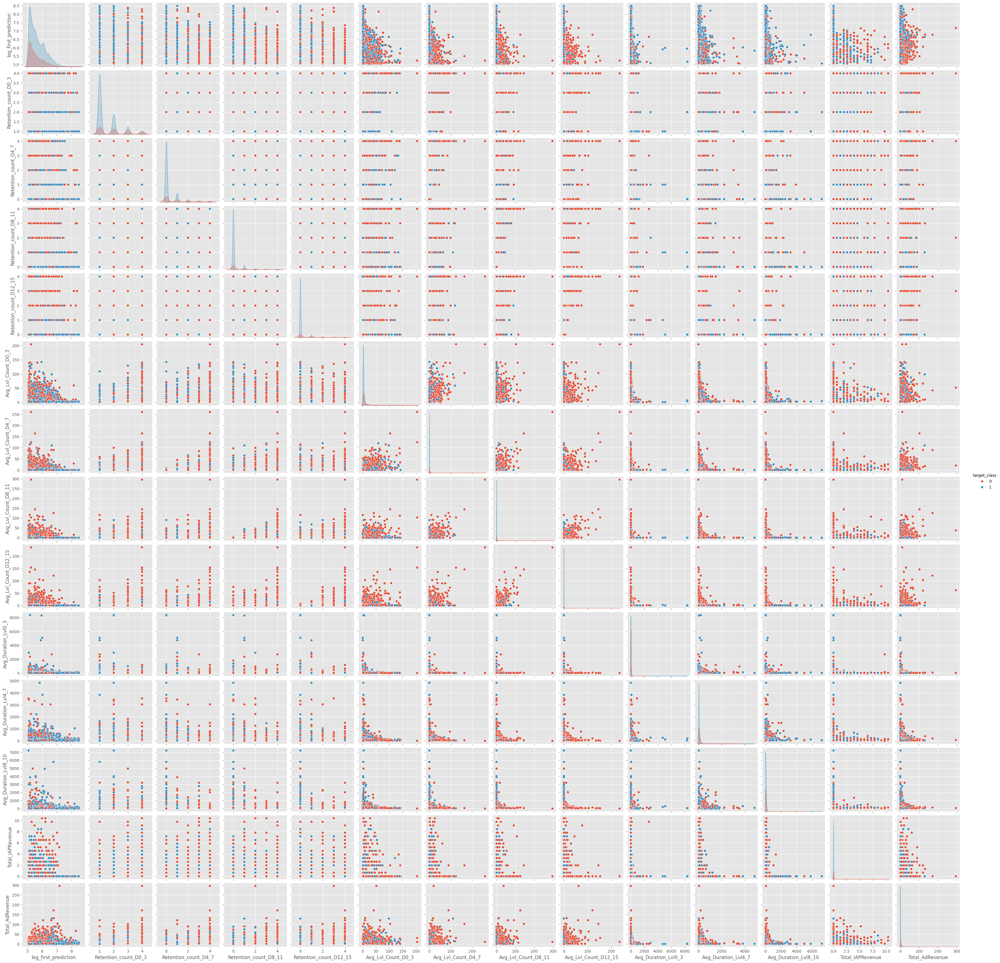

In [13]:
sns.pairplot(df_wealthy.loc[:,['target_class', 
                      'log_first_prediction',
                      'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
                      'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
                      'Avg_Duration_Lvl0_3', 'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 
                      'Total_IAPRevenue', 'Total_AdRevenue']],
            hue = 'target_class')

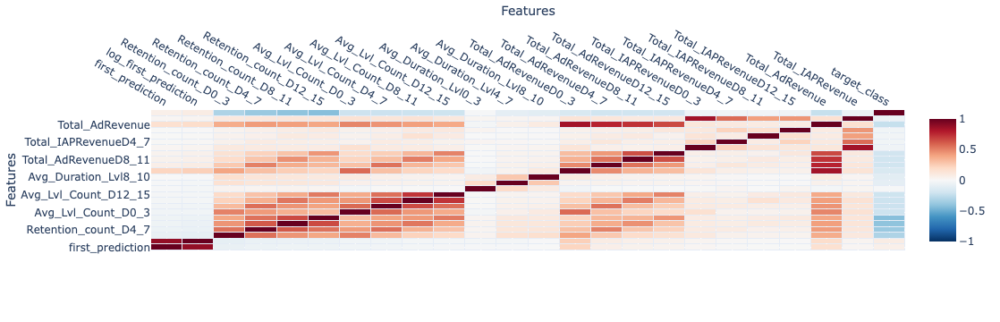

In [14]:
correlation_matrix = df_wealthy[X_cols].corr()

fig = go.Figure(data=go.Heatmap(
                   z = correlation_matrix,
                   x = correlation_matrix.columns,
                   y = correlation_matrix.index,
                   hoverongaps = False,
                   xgap = 1,
                   ygap = 1,
                   zmin = -1,
                   zmax = 1,
    colorscale = 'rdbu_r'
))

fig.update_xaxes(side="top")
fig.update_layout(xaxis_title = "Features", yaxis_title = "Features")
fig.show()

**Model**

In [15]:
X_cols = ['log_first_prediction',
         'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
         'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
         'Avg_Duration_Lvl0_3', 'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 
         'Total_IAPRevenue', 'Total_AdRevenue']

In [16]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score, confusion_matrix, accuracy_score

In [17]:
model = RandomForestClassifier(random_state = 128)

In [18]:
scaler = MinMaxScaler()
X = pd.DataFrame(scaler.fit_transform(df_wealthy[X_cols]), columns=df_wealthy[X_cols].columns)

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X, df_wealthy.target_class, test_size=0.2, random_state=42)

In [20]:
model.fit(X_train, y_train)

train_predictions = model.predict(X_train)
test_predictions = model.predict(X_test)

train_acc = accuracy_score(y_train, train_predictions)
test_acc = accuracy_score(y_test, test_predictions)

f1_train = f1_score(y_train, train_predictions)
f1_test = f1_score(y_test, test_predictions)

cm = confusion_matrix(y_test, test_predictions)

In [26]:
print(train_acc)
print(test_acc)

print(f1_train)
print(f1_test)

0.9998601447501836
0.804922388477136
0.999905459702198
0.8769298632554036


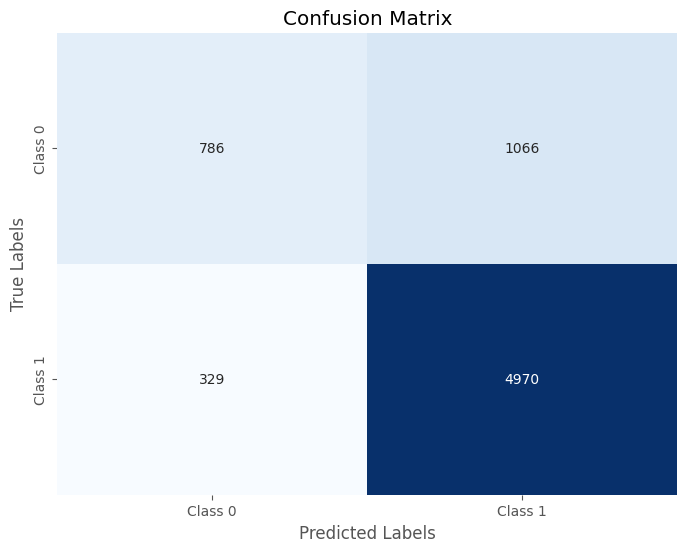

In [28]:
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False, xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

In [29]:
importances = model.feature_importances_

feature_importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

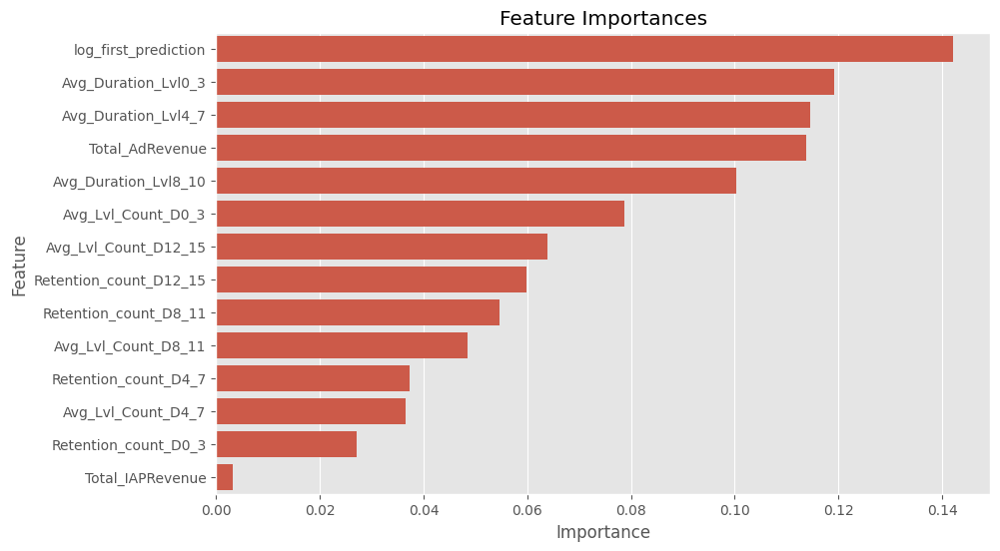

In [30]:
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df)
plt.title('Feature Importances')
plt.show()

In [31]:
with open('../../../models/wealthy_classifier.pkl', 'wb') as file:
    pickle.dump(model, file)